In [1]:
%matplotlib inline
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import warnings
import missingno as msno 
import seaborn as sns 
from sklearn.utils import shuffle
warnings.filterwarnings("ignore")

***Notes***

1. ```dt_complementary``` merges the original calendar and price data to know the ```date``` when the ```product_id``` of the ```store_id``` was saled at. Additionaly to know if they were particular events like ```SNAP``` purchases or major events, check the documentation.

2. ```dt_sales_s```. In case you don't have enough RAM take initial n rows of the original dataframe and shuffle the data, because it is ordered.

3. ```dt_sales_melt```. Melt the dataframe so that each sale by product can be seen as row.

4. ```dt_work```. Merges ```dt_sales_melt``` with ```dt_complementary``` to know for each day of sale the price and relevant events associated to that day.

#### Load and transform data

In [2]:
# Load data
files = ['data/calendar.csv', 'data/sales_train_validation.csv', 'data/sell_prices.csv']
data = [pd.read_csv(f) for f in files]
dt_calendar, dt_sales, dt_prices = data

# Merge calendar and prices
dt_complementary = dt_prices.merge(dt_calendar, how='left', on='wm_yr_wk')

# Shuffle data (it is originally ordered) and take n rows (if you don't have enough RAM)
dt_sales_s = shuffle(dt_sales, n_samples = 2000)

In [3]:
# Melt sales data
indicators = [f'd_{i}' for i in range(1,1914)]

dt_sales_melt = pd.melt(dt_sales_s, 
                        id_vars = ['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id'],
                        value_vars = indicators, var_name = 'day_key', value_name = 'sales_day')

dt_sales_melt['day'] = dt_sales_melt['day_key'].apply(lambda x: x[2:]).astype(int)

In [4]:
# Data to work with
columns = ['store_id','item_id','sell_price','date','year','d','event_name_1','event_type_1','event_name_2','event_type_2','snap_CA','snap_TX','snap_WI']
dt_work = dt_sales_melt.merge(dt_complementary[columns], how = 'left', left_on=['item_id','store_id','day_key'], right_on=['item_id','store_id','d'])
print(dt_work.shape)

(3826000, 20)


## Exploratory Data Analysis

The objective of this section is to get a general picture of possible relationships between the objective variable `sales` and the dependent variables like `sell_price` and `event_type`. Later on, we could confirm or reject this relationships through a Corfirmatory Data Analysis. 

#### Missing values 

* The initial heatmap `General glimpse` show us that there is missing data in relevant variables like `date` and `sell_price`. The variable `event_name` is natural to have this behavior because we're tagging only relevant days like the **superbowl**. 

* The `NA's as bar` allow us to see that only 20% of the data is missing. Therefore, we could assume to drop this missing data. However, we see that it is relate to the variable `d`, so we could plot the distribution of `sale_day` where `d` is missing to see if there were product with positive sell, if not we could savely discard this observations. The distribution plot of this variable show us that there is no sell these days, so we would discard null values based on the `d` column.

* To understand is the missing data is more promient by department, we sort the data by `department_id` and then plot the heatmap. If the missing data was homogeneously distributed we would see repeated patterns of missing data, but actually there are some particular periods by department when the `sell_price` and data is missing, it could be that this product stock out or that they decided to not sold it for a certain time. 

* Finally, the dendogram let us understand the correlate variable completition. For example, the `sales_day` could be completed with the information of the `snap_TX` variable. But, we would discard this results as we would further consider robust methods to this imputation like ***MICE*** or a bayesian one.

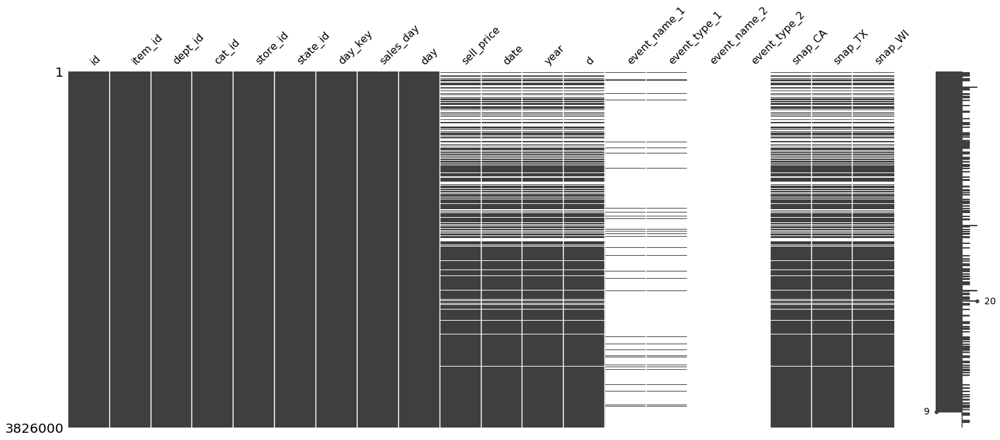

In [8]:
#General glimpse
msno.matrix(dt_work)

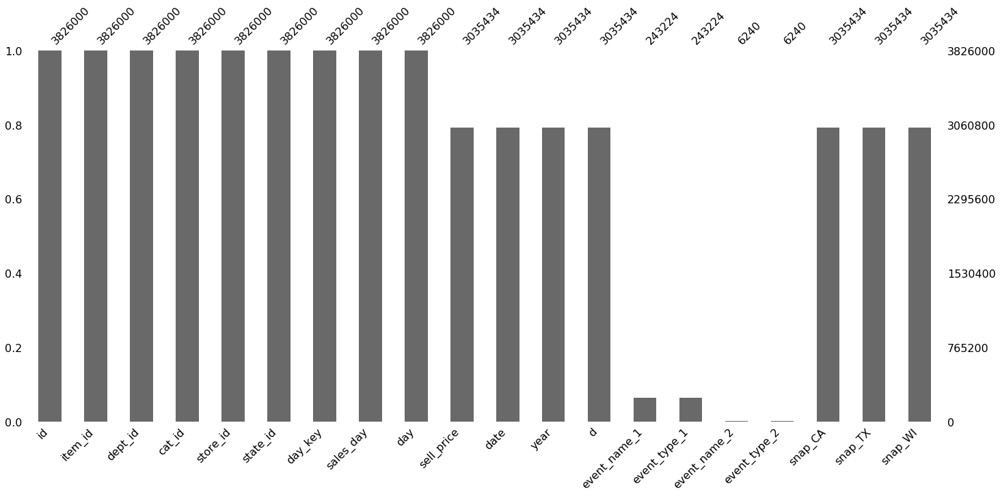

In [15]:
# NA's as bar plot
msno.bar(dt_work)

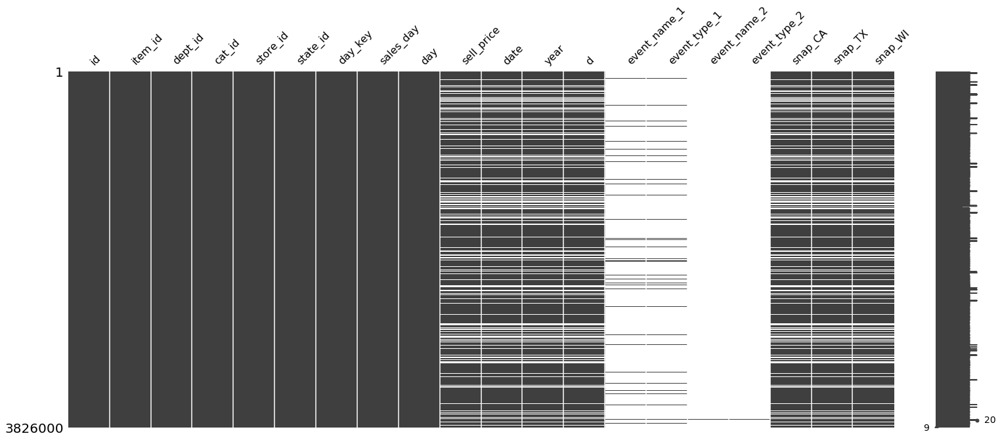

In [13]:
# NA's by department
msno.matrix(dt_work.sort_values(by=['dept_id']))

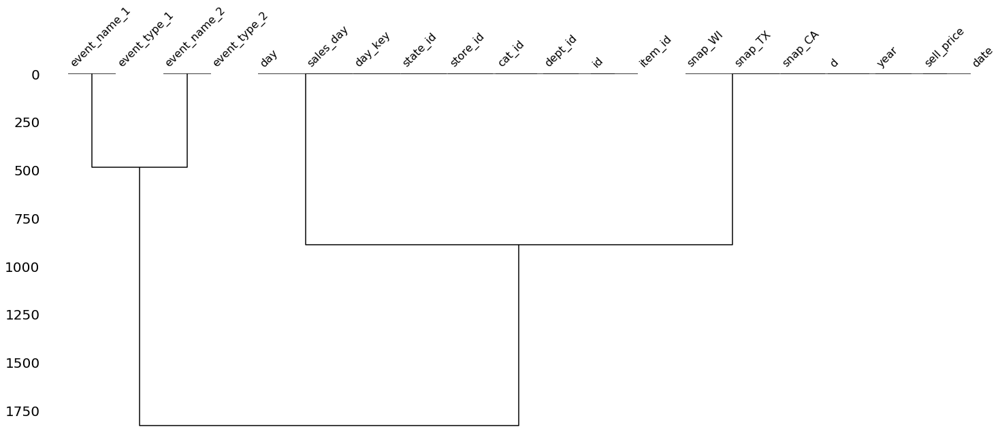

In [14]:
msno.dendrogram(dt_work)

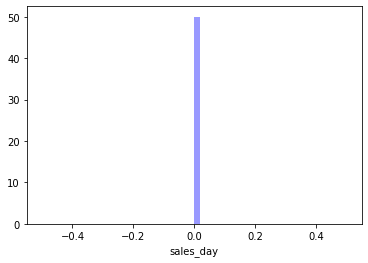

In [22]:
sns.distplot(dt_work[dt_work.d.isna()].sales_day, color='b')

In [7]:
print(dt_work.shape)
dt_work = dt_work.dropna(how='any', subset=['d'])
print(dt_work.shape)

(3826000, 20)
(3030653, 20)


#### Global Granularity

In this section, we visualize the time series of the ```sum``` of the ```sales_day``` and the ```mean``` of ```sell_price``` by different levels of granularity. For example, sales and price by state. Above, the ```particular granularity``` show us a deeper level of granularity by displaying the data for the different levels of granularity in each store, for example, the sales and price by category of each store. 

In [9]:
def timeseries_global(data:'pd.DataFrame',level:str):
    
    # Group data by level 
    dt_level = data.groupby([level, 'day']).agg({'sales_day':'sum','sell_price':'mean'}) \
                                                         .reset_index() \
                                                         .sort_values(by=[level,'day'])
    
    # Visualize by components of level 
    levels = dt_level[level].unique()

    for l in levels: 
        df = dt_level[(dt_level[level] == l)]
        f, (ax1, ax2) = plt.subplots(1, 2, sharey=False, figsize=(16,8))
        plt.style.use('ggplot')
        ax1.plot(df['sales_day'], color = 'blue')
        ax1.set_xticklabels(labels = df.day.values, rotation=70)
        ax1.grid(False)
        ax1.set_title(f"Time series of sales for {l}")
        ax2.plot(df['sell_price'], color = 'red')
        ax2.set_xticklabels(labels = df.day.values, rotation=70)
        ax2.grid(False)
        ax2.set_title(f"Time series of price for {l}")

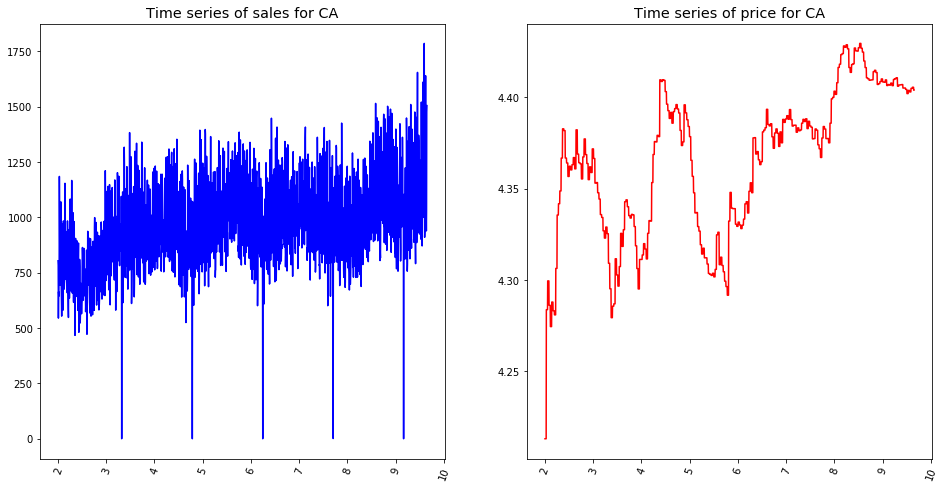

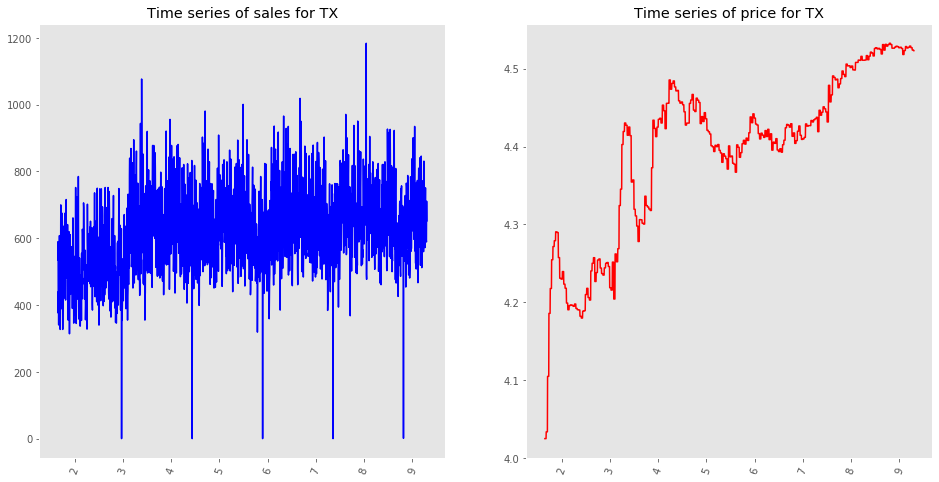

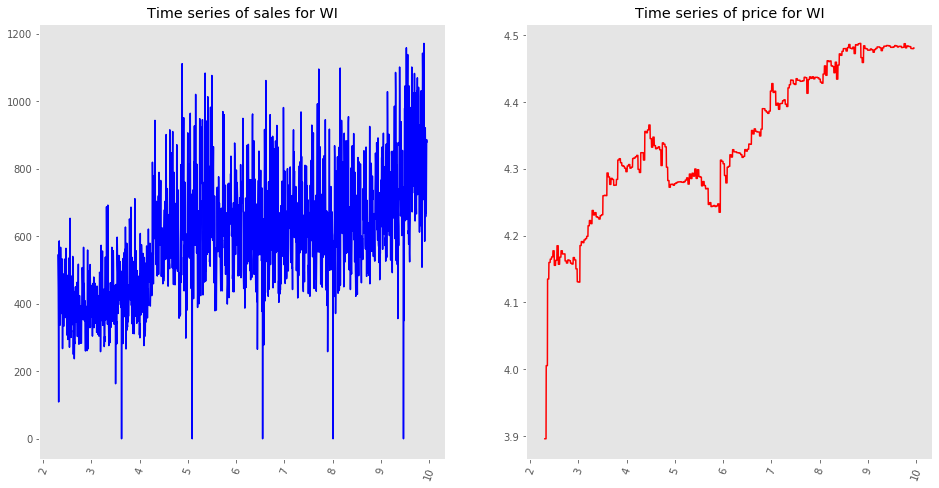

In [10]:
# State level
timeseries_global(dt_work,'state_id')

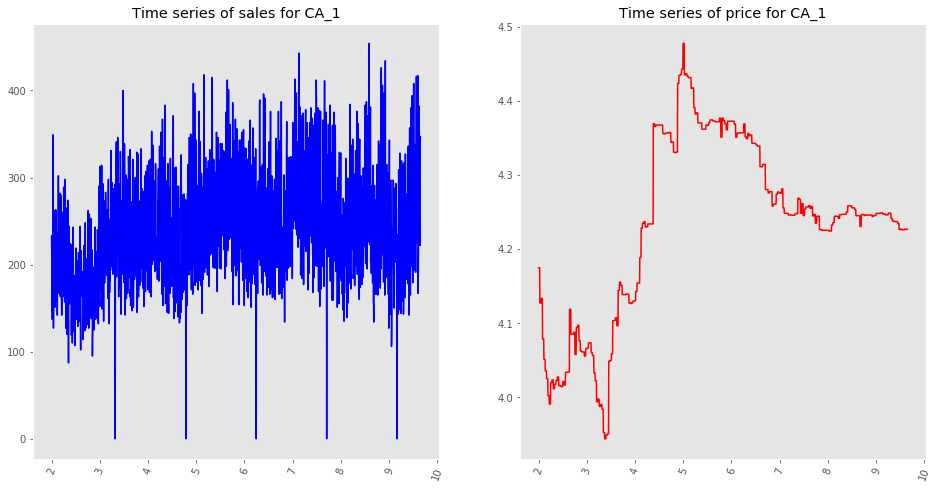

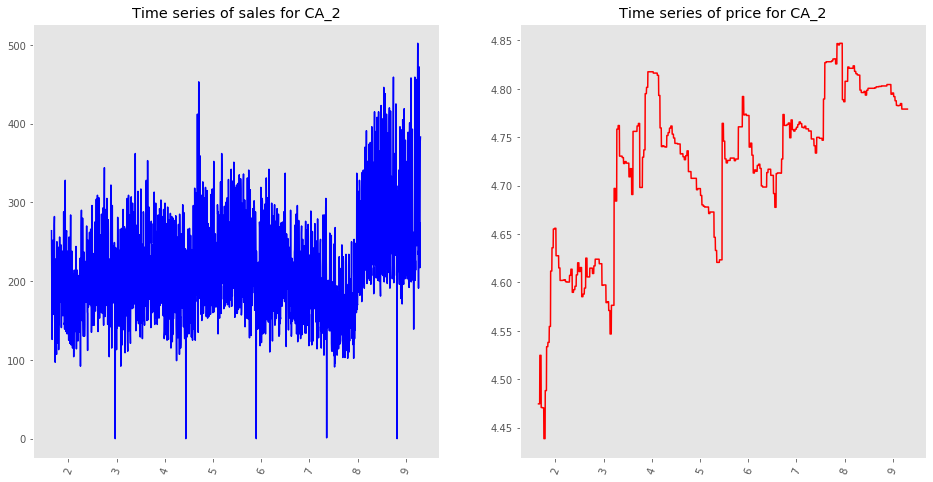

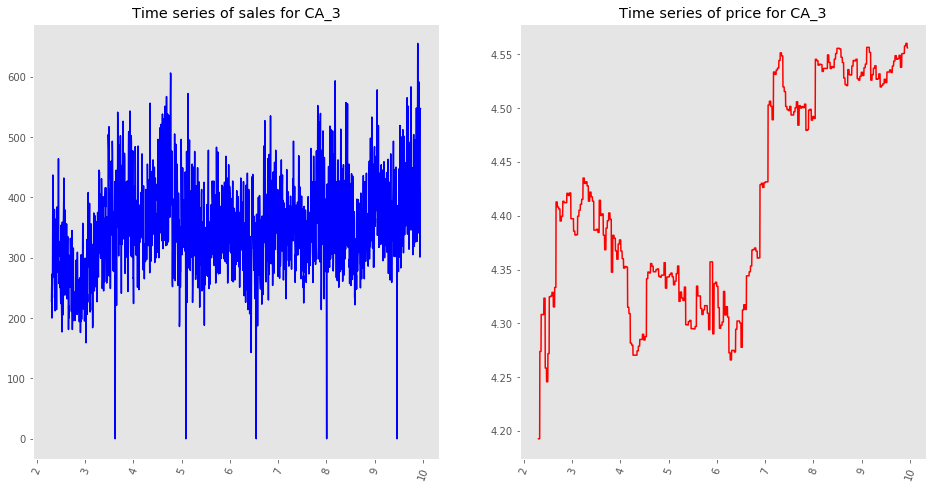

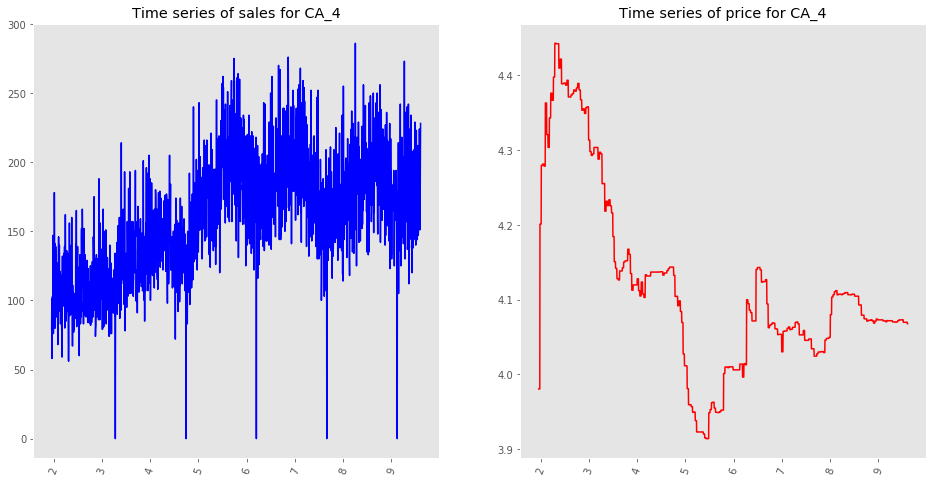

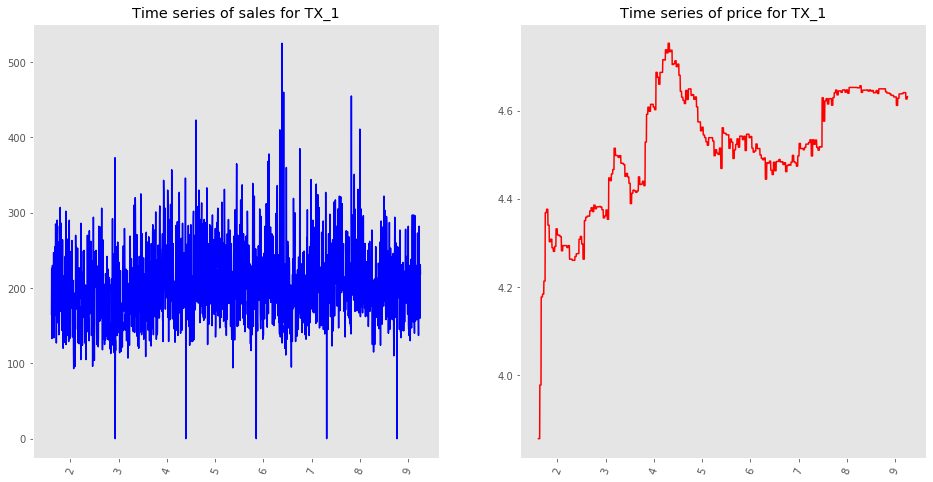

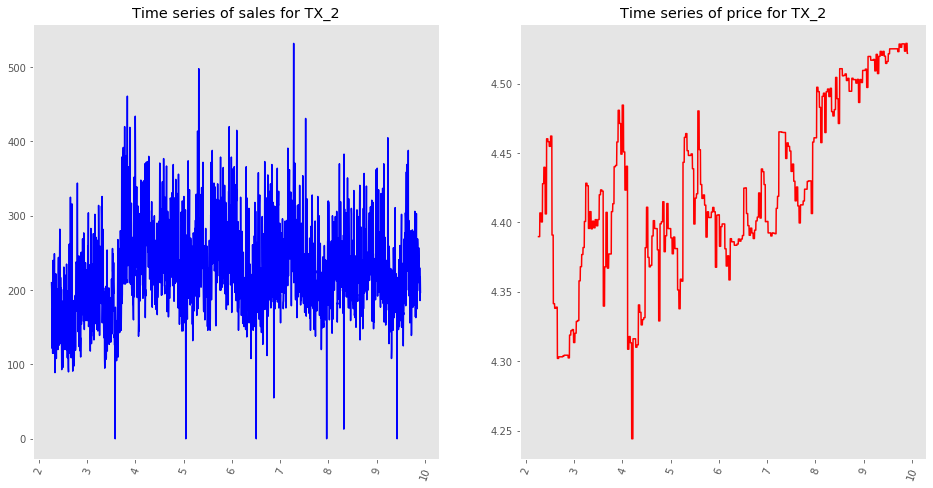

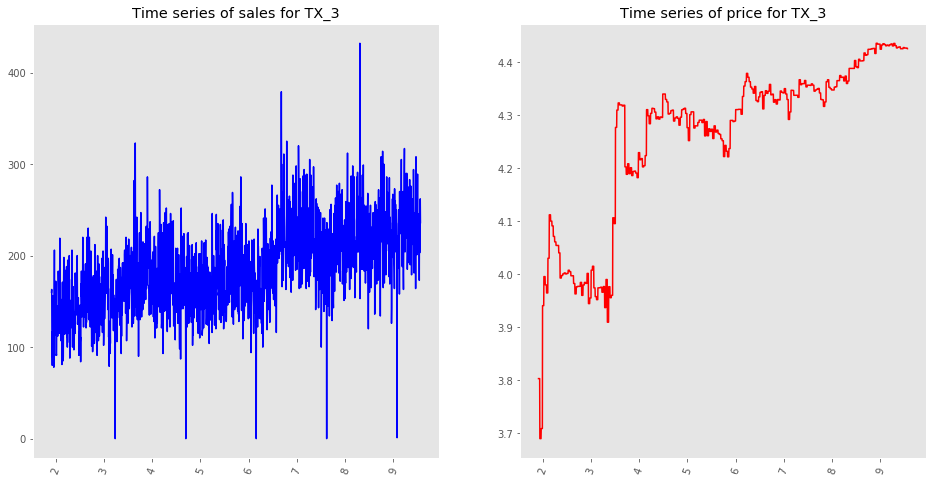

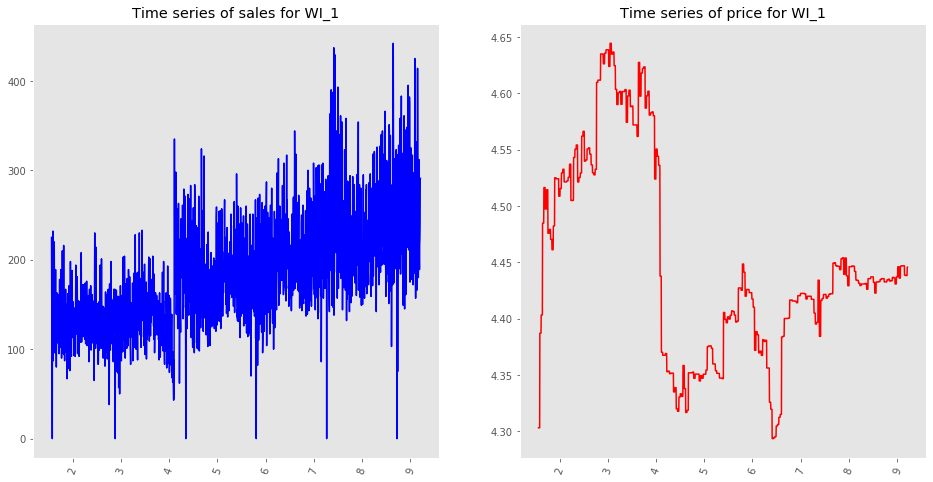

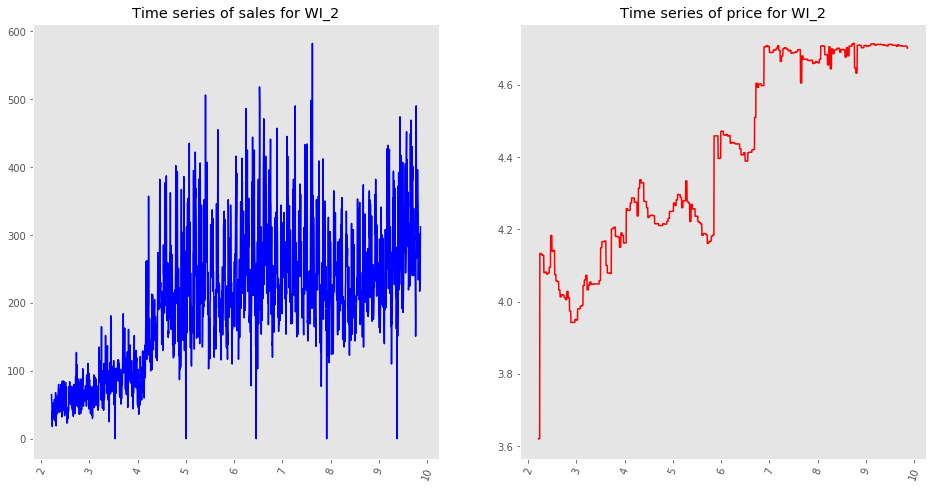

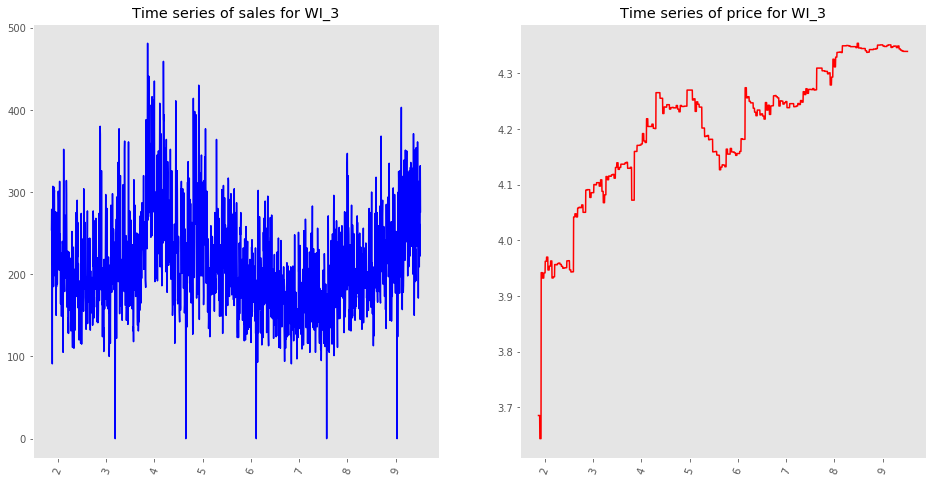

In [11]:
# Store level
timeseries_global(dt_work,'store_id')

By visualizing the data by `state_id` and `store_id` we see a general upward trend of average `sell_price` and sales. However, there are some particular behaviors like `CA_2` that suddenly pops up its sales from the 8 observation on. The genera conclusion as that we level down the level of granularity we see the particular behaviors of set of data, that is, if we consider data only by state level we could strongly affirm that the sales and the prices are augmenting with the time, but as we further level down the level of granularity we conclude that there are particular behaviors. 

Therefore, let's plot the data considering departments and categories by each store, this we will call it the **particular granularity** level. 

#### Particular granularity

In [12]:
def timeseries_particular(data:'pd.DataFrame',level_1:str, level_2:str):
    
    # Group data by level 
    dt_level = data.groupby([level_1,level_2, 'day']).agg({'sales_day':'sum','sell_price':'mean'}) \
                                                               .reset_index() \
                                                               .sort_values(by=[level_1,level_2,'day'])
    
    # Visualize by components of level 
    l1, l2 = dt_level[level_1].unique(), dt_level[level_2].unique() 
    iterables = [(a, b) for a in l1 for b in l2]

    for i in iterables: 
        a, b = i
        df = dt_level[(dt_level[level_1] == a) & (dt_level[level_2] == b)]
        f, (ax1, ax2) = plt.subplots(1, 2, sharey=False, figsize=(16,8))
        plt.style.use('ggplot')
        ax1.plot(df['sales_day'], color = 'blue')
        ax1.set_xticklabels(labels = df.day.values, rotation=70)
        ax1.grid(False)
        ax1.set_title(f"Time series of sales for {a} and {b}")
        ax2.plot(df['sell_price'], color = 'red')
        ax2.set_xticklabels(labels = df.day.values, rotation=70)
        ax2.grid(False)
        ax2.set_title(f"Time series of price for {a} and {b}")

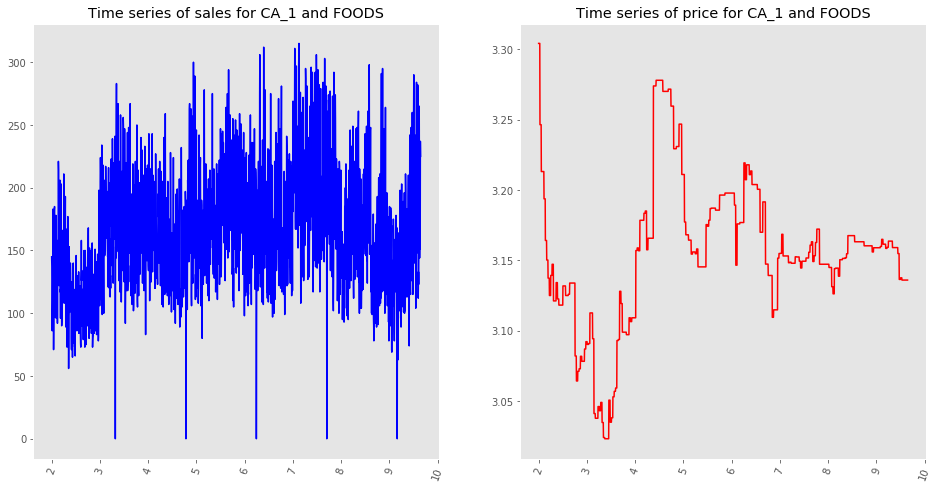

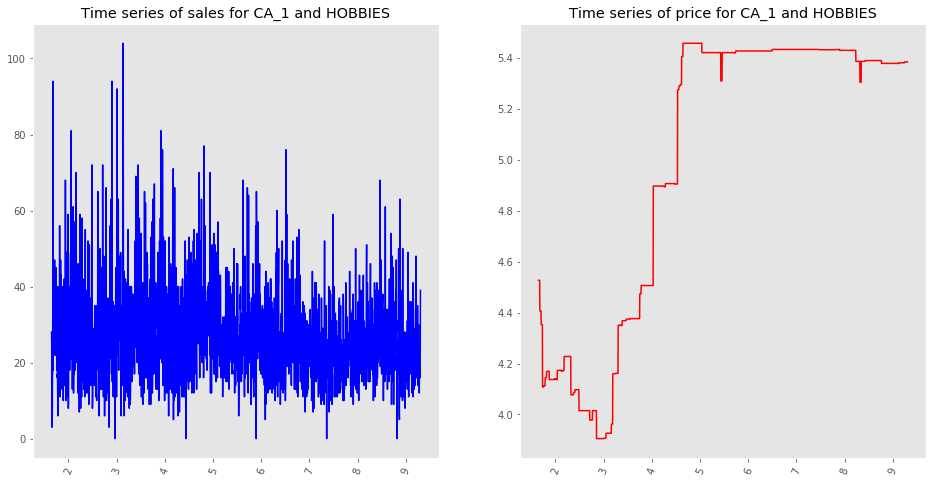

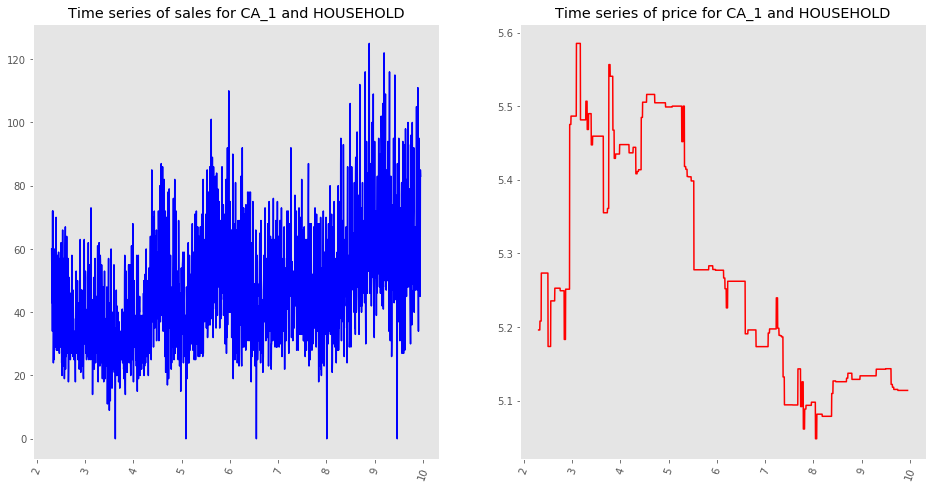

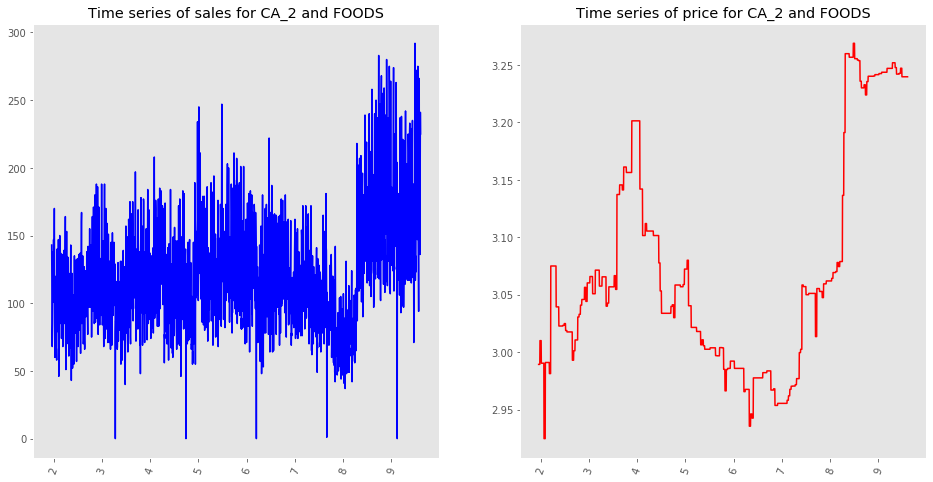

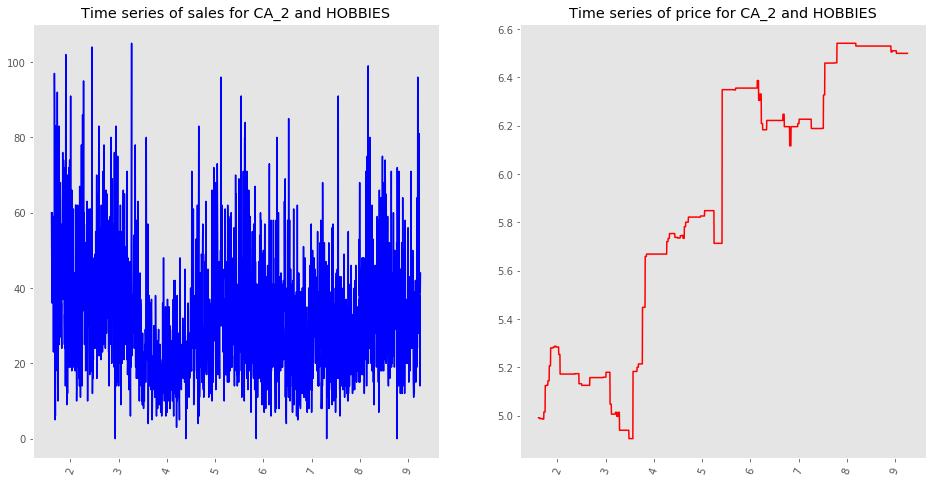

...

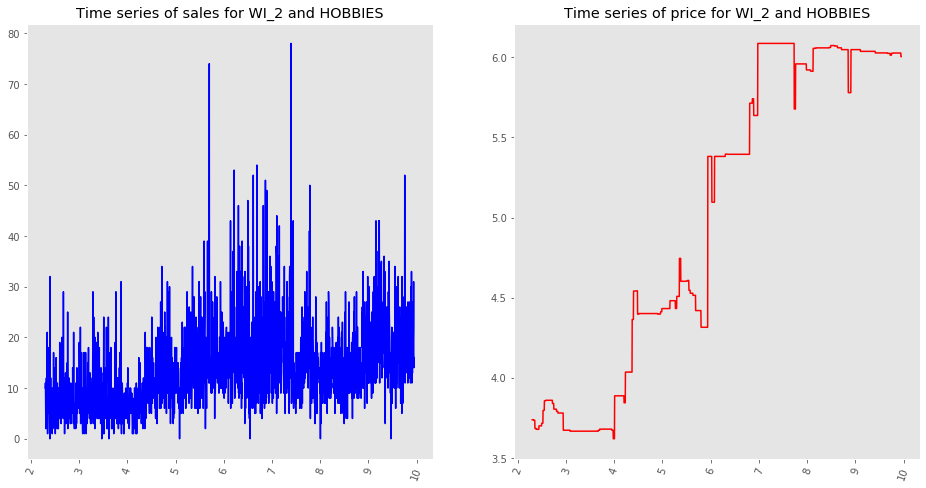

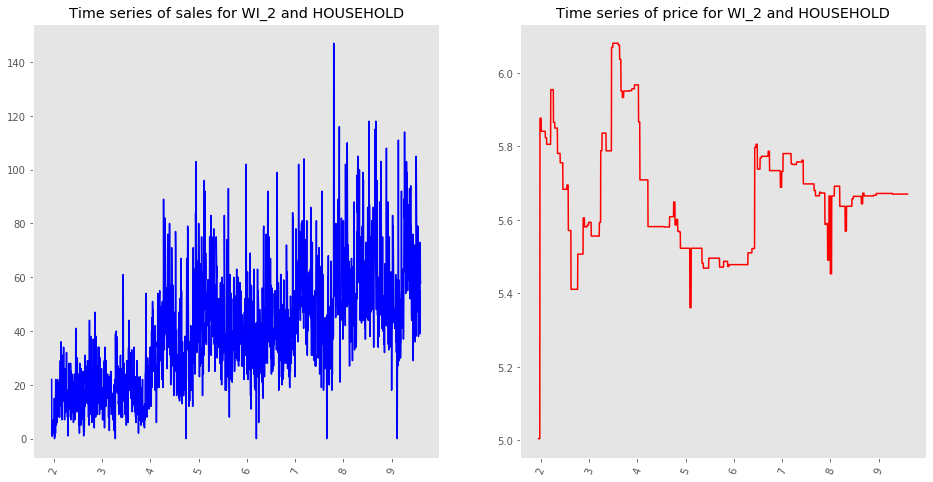

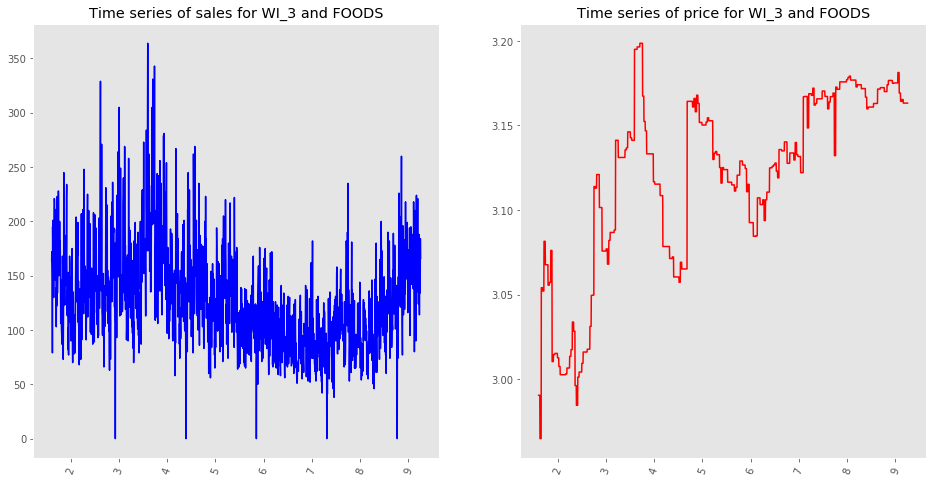

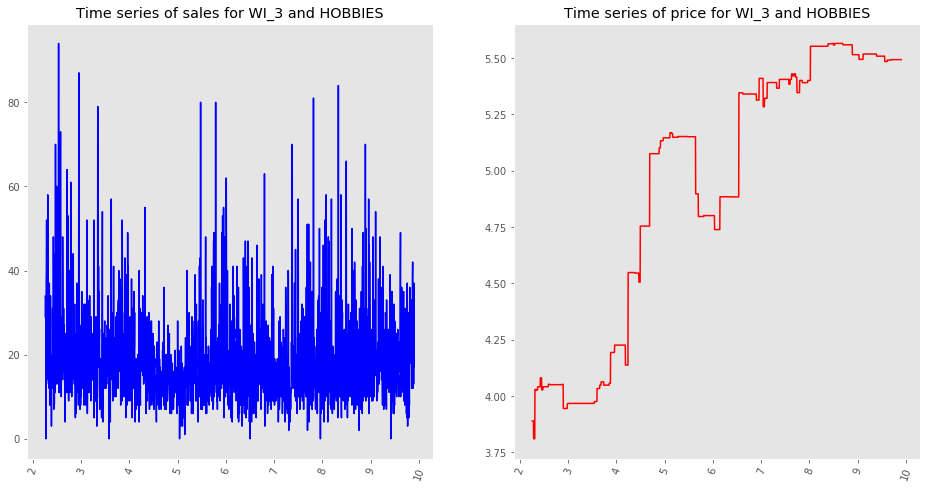

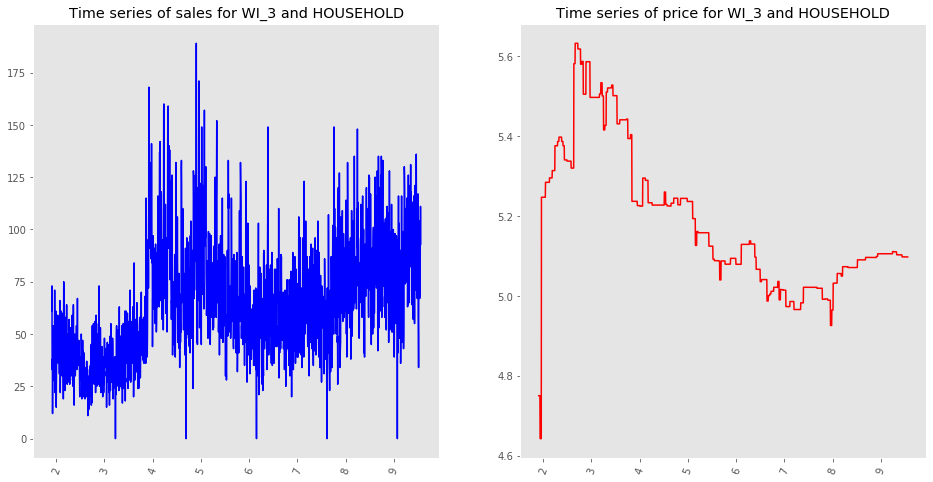

In [13]:
# Level: Categories of each store 
timeseries_particular(dt_work,'store_id', 'cat_id')

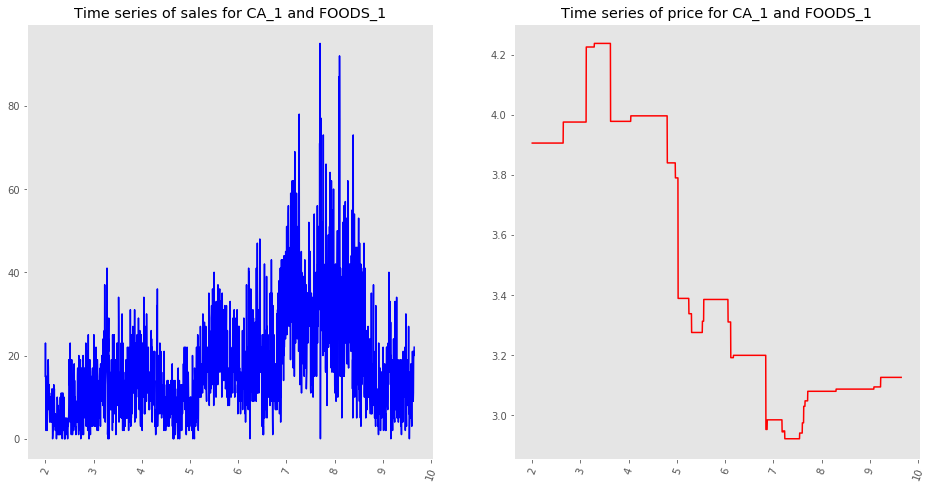

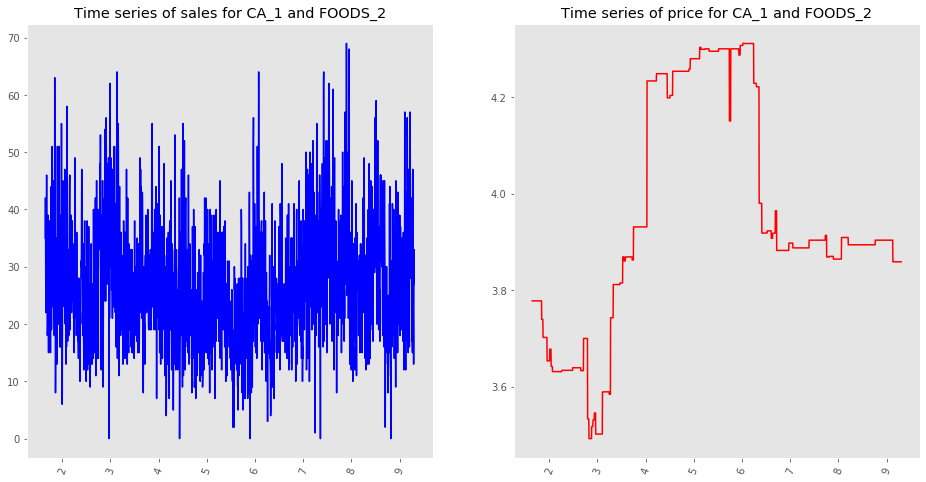

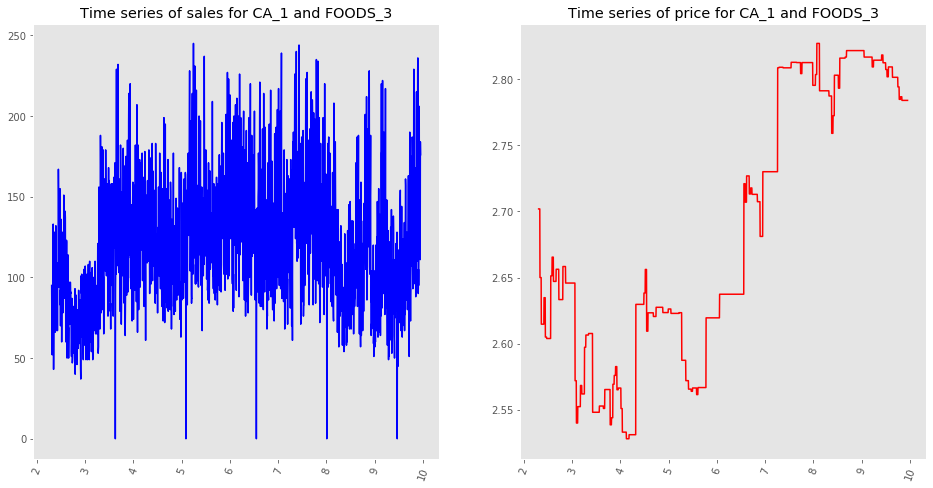

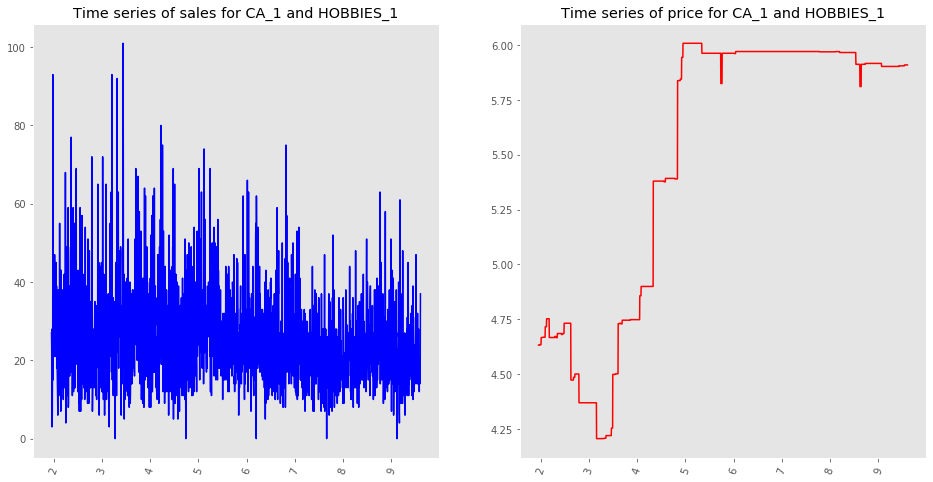

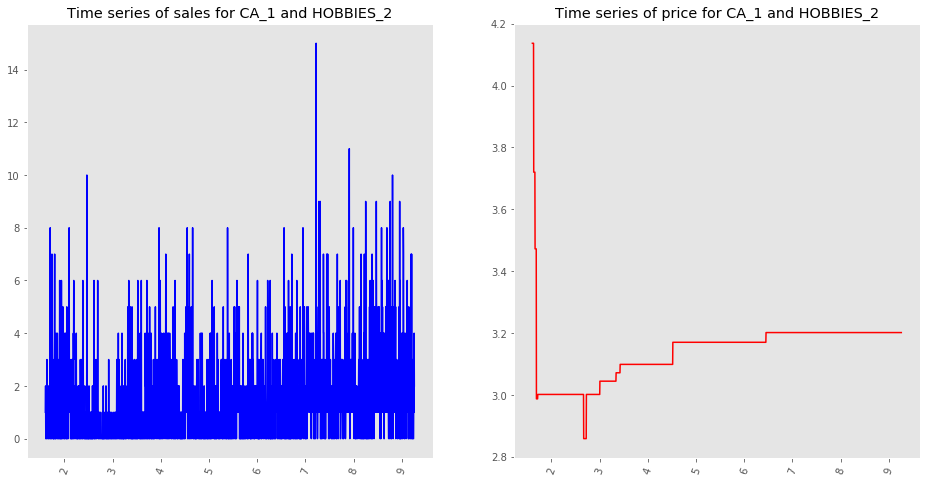

...

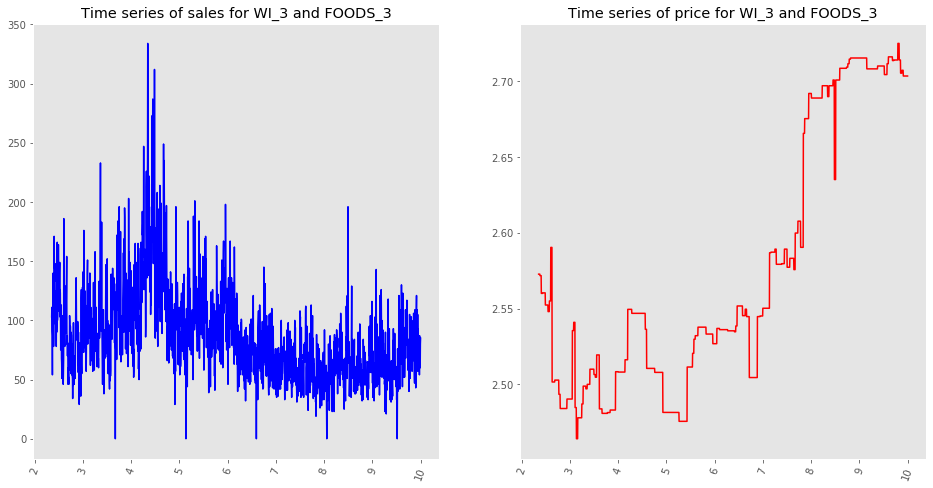

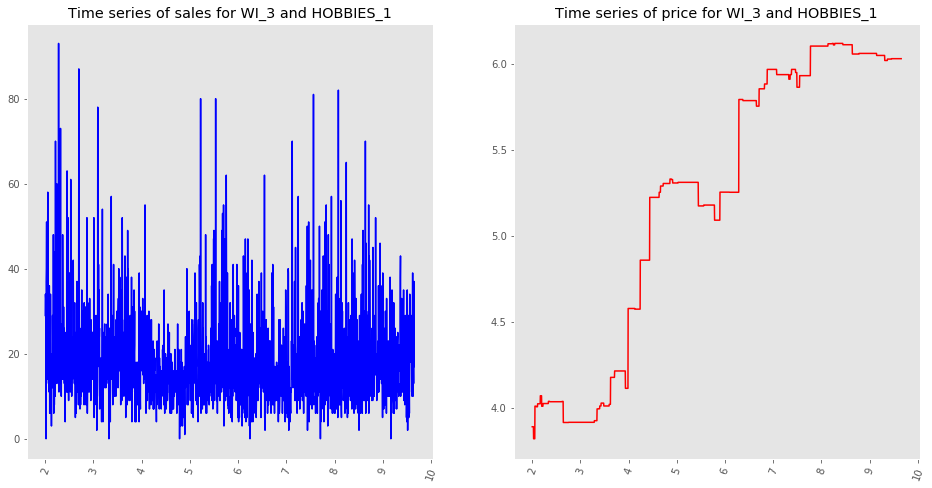

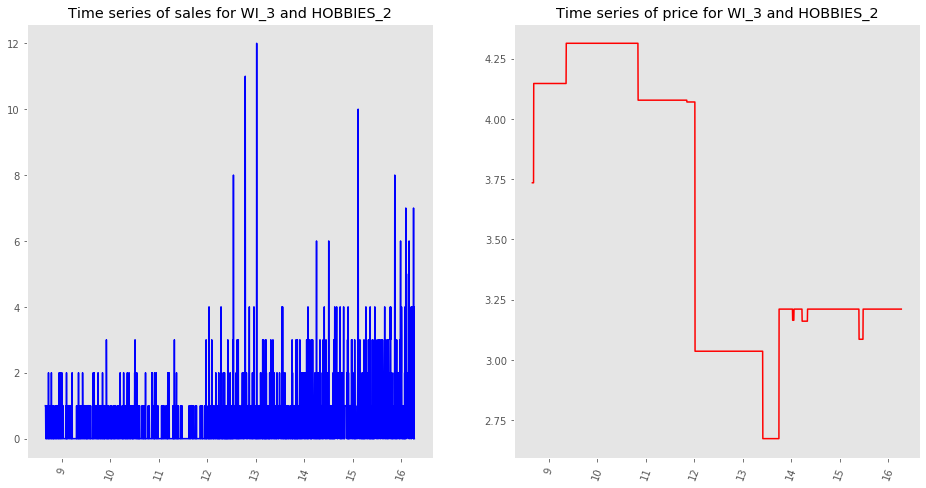

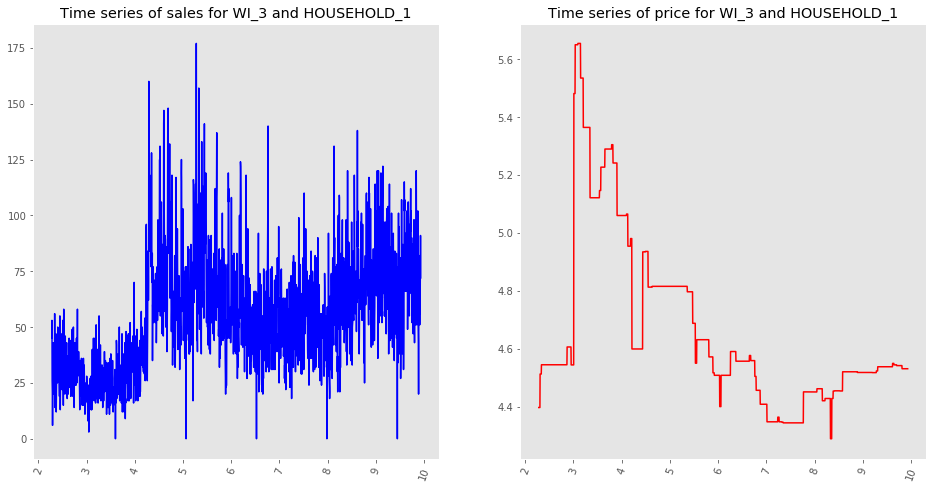

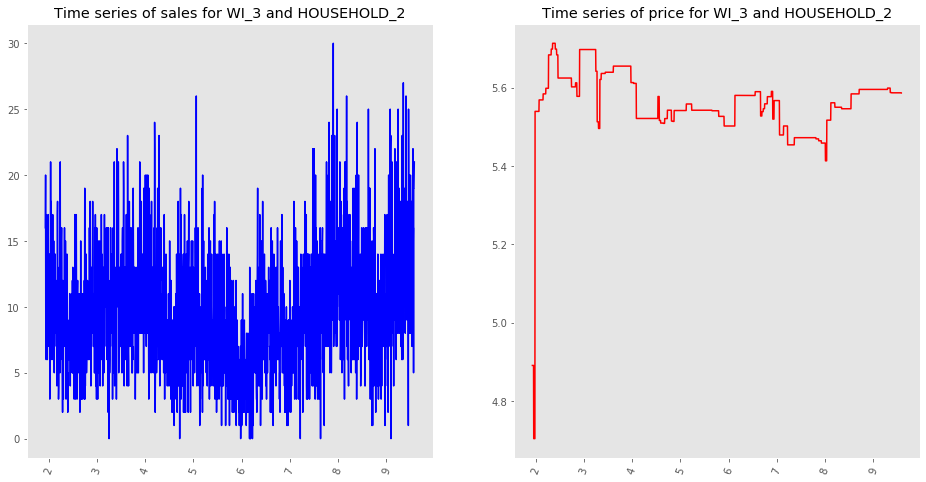

In [15]:
# Level: departments by store
timeseries_particular(dt_work, 'store_id', 'dept_id')

Now we get to the level that we could discern some relationship between the sales and the price variable, that is, if the price decrease the sale is going to increase like in the `FOODS_1` department of `CA_1`. On the other hand, we see the opposite relationship in the `FOODS_2` department of `CA_2`, that when the price goes up the sale goes up.

One more thing to notice is that there are periods where the price remains constant for a long time and then suddenly goes up or down. To further analysis this behavior, let's use the dash library that allow us to use a date slider.

In [36]:
import plotly.graph_objects as go

def timeseries_range_slider(data:'pd.DataFrame',level_1:str, level_2:str):
     
    # Group data by level 
    dt_level = data.groupby([level_1,level_2, 'date']).agg({'sales_day':'sum','sell_price':'mean'}) \
                                                      .reset_index() \
                                                      .sort_values(by=[level_1,level_2,'date'])
    
    # Visualize by components of level 
    l1, l2 = dt_level[level_1].unique(), dt_level[level_2].unique() 
    iterables = [(a, b) for a in l1 for b in l2]

    for i in iterables: 
        a, b = i
        df = dt_level[(dt_level[level_1] == a) & (dt_level[level_2] == b)]
        
        mxm = max(df['sales_day'])
        if mxm < 50:
            weight = 5
        elif mxm < 100:
            weight = 10
        elif mxm < 200: 
            weight = 25  
        else:
            weight = 35
        
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=df.date, 
                                 y=df['sales_day'], 
                                 name='Sales',
                                 line_color='deepskyblue'))

        fig.add_trace(go.Scatter(x=df.date, 
                                 y=df['sell_price']*weight, 
                                 name='Price average',
                                 line_color='dimgray'))

        fig.update_layout(title_text=f'Time Series of sales with Rangeslider for {a} and {b}',
                          xaxis_rangeslider_visible=True)
        fig.show()

In [37]:
timeseries_range_slider(dt_work, 'store_id', 'dept_id')

* One of the key advantages of the time slider is that it allow us to better visualize unusual behavior in the data. For example for the department `HOBBIES_2` of the state `CA_3` it has an usual sale value the 11th of December, maybe some product was on special sale before Christmas. 

* Another advantage of this visualization is that let us confirm seasonality patterns in the sale and to understand that this is not related to the price, becuase there are case where the price is constant or has a constant trend but the sales fluctuates like the `HOUSEHOLD` department of `WI_3` from Jun 2012 on.

* By noticing this particular behavior first we would need to relate these particular sales day to an event provided in the dataset. If we see that there is no relationship at all, we could use statistical tools for outlier treatment or structural breaks.